In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
import time
import glob
import datetime
import statsmodels.formula.api as smf
import statsmodels.api as sm

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier

from textblob import TextBlob
from textblob.classifiers import NaiveBayesClassifier
from textblob.sentiments import NaiveBayesAnalyzer

/Applications/anaconda/lib/python2.7/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


## How did I create the "master data"?

In [2]:
"""

lyrics_data_clean = pd.read_csv('../MSD-Data/datasets/data_final.csv')
lyrics_data_clean.rename(columns={'count':'word_count'}, inplace=True)
lyrics_data_clean['unstemmed_word'] = lyrics_data_clean['unstemmed_word'].astype(str)

lyrics_2 = lyrics_data_clean[(lyrics_data_clean.genre_id == 'Country') | 
(lyrics_data_clean.genre_id == 'Electronic') | (lyrics_data_clean.genre_id == 'RnB') | 
(lyrics_data_clean.genre_id == 'Rap')]

words_list = []
for row_id, row in lyrics_2.iterrows():
    words_list.append(' '.join(np.repeat(row.unstemmed_word, row.word_count)))
    
lyrics_2['words_list'] = words_list

lyrics_2['words_list'] = lyrics_2['words_list'].astype(str)

lyrics = lyrics_2.groupby(['track_id','artist_name','genre_id','artist_familiarity',
'artist_hotttnesss'])['words_list'].apply(lambda x: ' '.join(x)).reset_index()

lyrics.to_csv('../MSD-Data/datasets/lyrics_master.csv',index=False)

lyrics_2 = lyrics.groupby('genre_id')['words_list'].apply(lambda x: ' '.join(x)).reset_index()

lyrics_2.to_csv('lyrics.csv',index=False)

"""

"\n\nlyrics_data_clean = pd.read_csv('../MSD-Data/datasets/data_final.csv')\nlyrics_data_clean.rename(columns={'count':'word_count'}, inplace=True)\nlyrics_data_clean['unstemmed_word'] = lyrics_data_clean['unstemmed_word'].astype(str)\n\nlyrics_2 = lyrics_data_clean[(lyrics_data_clean.genre_id == 'Country') | \n(lyrics_data_clean.genre_id == 'Electronic') | (lyrics_data_clean.genre_id == 'RnB') | \n(lyrics_data_clean.genre_id == 'Rap')]\n\nwords_list = []\nfor row_id, row in lyrics_2.iterrows():\n    words_list.append(' '.join(np.repeat(row.unstemmed_word, row.word_count)))\n    \nlyrics_2['words_list'] = words_list\n\nlyrics_2['words_list'] = lyrics_2['words_list'].astype(str)\n\nlyrics = lyrics_2.groupby(['track_id','artist_name','genre_id','artist_familiarity',\n'artist_hotttnesss'])['words_list'].apply(lambda x: ' '.join(x)).reset_index()\n\nlyrics.to_csv('../MSD-Data/datasets/lyrics_master.csv',index=False)\n\n\n"

## Read in master data

In [34]:
lyrics = pd.read_csv('../MSD-Data/datasets/lyrics_master.csv')

In [4]:
lyrics.head()

,track_id,artist_name,genre_id,artist_familiarity,artist_hotttnesss,words_list
0,TRAAAHZ128E0799171,Snoop Dogg,Rap,0.853832,0.608910,i i i i i i i i i i i i i i i i i i i i i i i ...
1,TRAABHC128F933A3F8,The Sunny Cowgirls,Country,0.526451,0.328403,i i i the the the the the the the the the the ...
2,TRAABJV128F1460C49,Lionel Richie,RnB,0.776676,0.553072,i i i i i i the the the the the you you you yo...
3,TRAACZN128F93236B1,Saul Williams,Rap,0.707387,0.442664,i i i i i i i i i i i i i i i i i i i the the ...
4,TRAADKA12903CD2511,BLESTeNATION,Rap,0.559062,0.382228,i i i i i i i i i i i i i i i i i i i i i i i ...


In [6]:
lyrics_2 = pd.read_csv('../MSD-Data/datasets/lyrics.csv')

In [7]:
lyrics_rnb = lyrics_2['words_list'][lyrics_2.genre_id == 'RnB']

In [10]:
lyrics_rnb.values.tolist()

["i i i i i i the the the the the you you you you you you you you you you to to to to and and and and and and a a me me me me me me it it it it it it don't my my is do do on on on on we we we am will will will will all no be be be be be have have have love so so but just time can can come come oh oh out down see see if feel want want let let make say say say take baby baby baby baby baby heart here our where 'cause 'cause 'cause 'cause 'cause gonna gonna been been tell tell think think again again keep well well us us long girl girl girl girl wanna about about little little little ya has soul tonight tonight tonight play break move fire fire used real sound ride till town set alright alright alright alright alright alright alright alright alright alright alright alright alright game anything anything anything strong great honey honey cool darling darling darling mad rules desire midnight highway celebrate i i i i i i i i i i i i i i i i i i i i i i i i i i i i the the the the the the t

In [8]:
lyrics_country = lyrics_2['words_list'][lyrics_2.genre_id == 'Country']

In [11]:
lyrics_country.values.tolist()

["i i i the the the the the the the the the the the the the the the the you you you you you you you you to to to to and and and and and and and and me me me me me me me me it don't in in in my my is of of your your your that that that on are are are we we we we we we am will will will will will will will for be be know know with with just just just like like time time time go up oh they they out down want make as as day day day away away here here here night our where eyes eyes right right through through through through too well find find find fall around little waiting hold run them stay stay another sun off sky hope hope watch watch same own other other forever close kiss two open il side fly found once together shine many morning sit fade fade follow follow wake blind each reach soon above tree different summer outside outside 'cos spend slowly slowly beside beside remind below wrapped weather seed underneath breeze wherever creep w pink pink pink collide mate grain pine branches i

In [9]:
lyrics_electronic = lyrics_2['words_list'][lyrics_2.genre_id == 'Electronic']

In [12]:
lyrics_electronic.values.tolist()

["i i i i i i i i i i i i i i i i i i i i i i i i i i the the the the the the the you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you you to to to to to to to to to to to to to and a a a me me me me me me me me me me me me me me me me me me it it it it it it it in my my my my my my is is is is is is is is of of of your your are are are am will all all all all all be have have have have have have have love love love love love love love love love love love so know know know know know know know know know know know know know know know with with what just when like like up up up oh oh oh oh oh oh see see from from from feel would would would would baby life life life life life yeah could need need need need need need need need need more more more more more live give give give give give give give give give give dream light always always always al

In [24]:
lyrics_rap = lyrics_2['words_list'][lyrics_2.genre_id == 'Rap']

In [37]:
lyrics_rap.values.tolist()

["i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i i the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the you you you you you you you you you you to to to to to to to to to to and and and and and and and and and and and and and and and and and and and and and and and and and and and and a a a a a a a a a a a a a a a a a a a a a me it it it it it it it it it it it it it it it it it it it it don't don't don't don't don't don't don't don't don't don't don't in in in in in in in in in in in in my my my my my my my my my is is is is is is is is is is of of of of of of of of of your that that that that that do do do do do do do do do do do on on on on are we am am am am am am am am am am am am am am am am am all all all all all all all for for for for no have have love love so so so so so know this this this this this this but but but but but with with with with what what when like now now now now n

In [13]:
with open('../MSD-Data/datasets/rnb.txt','w') as file:
    for item in lyrics_rnb:
        print>>file, item

In [14]:
with open('../MSD-Data/datasets/country.txt','w') as file:
    for item in lyrics_country:
        print>>file, item

In [15]:
with open('../MSD-Data/datasets/electronic.txt','w') as file:
    for item in lyrics_electronic:
        print>>file, item

In [38]:
with open('../MSD-Data/datasets/rap.txt','w') as file:
    for item in lyrics_rap:
        print>>file, item

## Wordclouds

In [27]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
from PIL import Image
stopwords = set(STOPWORDS)

In [28]:
text = open('../MSD-Data/datasets/country.txt').read()
country_mask = np.array(Image.open("images/shapes/guitar.jpeg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/country.png")

In [29]:
text = open('../MSD-Data/datasets/rnb.txt').read()
country_mask = np.array(Image.open("images/shapes/piano2.jpg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/rnb.png")

In [30]:
text = open('../MSD-Data/datasets/electronic.txt').read()
country_mask = np.array(Image.open("images/shapes/dj.jpg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/electronic.png")

In [39]:
text = open('../MSD-Data/datasets/rap.txt').read()
country_mask = np.array(Image.open("images/shapes/hip-hop-orig.jpg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/rap.png")

In [42]:
lyrics_biggie = lyrics['words_list'][lyrics.artist_name == 'The Notorious B.I.G.']
lyrics_2pac = lyrics['words_list'][lyrics.artist_name == '2Pac']

In [43]:
lyrics_biggie.values.tolist()
lyrics_2pac.values.tolist()

["i i i i i i you you you you you you you you to and a a me me it it don't don't don't don't my is is is is is of of of your your your that that that that that that that that do on are we all all all all all all all have have have know know but with what what when when there there there there go one out out if if got say say ca at how look more more 'cause 'cause 'cause gonna die die die die tell through live live us find find around then them ya ya something something something something something something change change change than hard name name name remember remember kill black found bad deep deep deep deep ai best hell young strong nan nan nan nan nan point brain guy strange fingers grave poor check ta ta crack below rich bottle nan nan nan nan nan nan nan echo echo teach teach laughter laughter fame united united strip crumble momma tha tha tha tha tha tha rearrange juice",
 "i i i i i i i i i i i i i i i i the the the the the the the the the the the the the the the the the you y

In [44]:
with open('../MSD-Data/datasets/biggie.txt','w') as file:
    for item in lyrics_biggie:
        print>>file, item

In [45]:
with open('../MSD-Data/datasets/2pac.txt','w') as file:
    for item in lyrics_2pac:
        print>>file, item

removed nans manually in txt file (find and replace)

In [48]:
text = open('../MSD-Data/datasets/biggie.txt').read()
country_mask = np.array(Image.open("images/shapes/biggie.jpg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/biggie.png")

In [49]:
text = open('../MSD-Data/datasets/2pac.txt').read()
country_mask = np.array(Image.open("images/shapes/2pac.jpg"))
wc = WordCloud(background_color="white", max_words=10000, mask=country_mask)
wc.generate(text)
wc.to_file("images/wordclouds/2pac.png")

In [50]:
lyrics_g = lyrics[(lyrics.artist_name == 'The Notorious B.I.G.') | (lyrics.artist_name == '2Pac')]

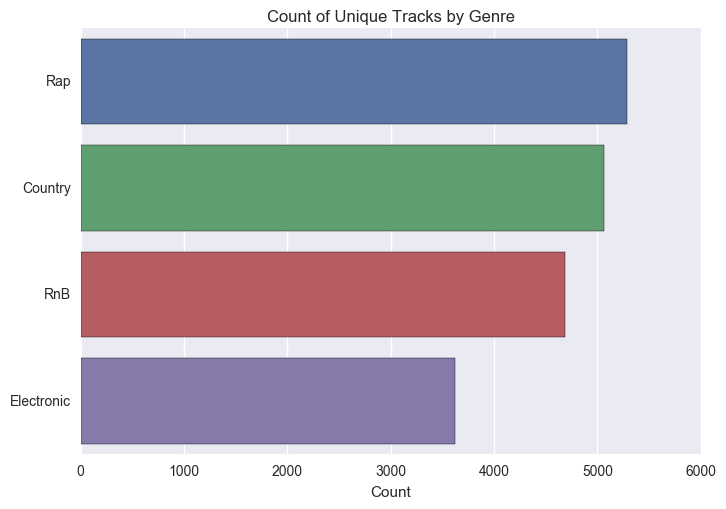

In [51]:
sns.countplot(y='genre_id', data=lyrics)
plt.ylabel('')
plt.xlabel('Count')
plt.title('Count of Unique Tracks by Genre')

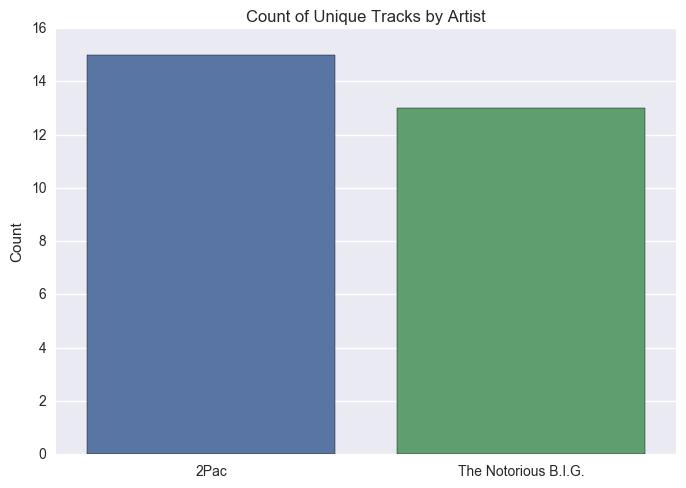

In [52]:
sns.countplot(x='artist_name', data=lyrics_g)
plt.xlabel('')
plt.ylabel('Count')
plt.title('Count of Unique Tracks by Artist')

In [55]:
lyrics.genre_id.value_counts()

Rap           5291
Country       5064
RnB           4689
Electronic    3624
Name: genre_id, dtype: int64

In [56]:
lyrics['baby'] = lyrics['words_list'].str.contains('baby')
lyrics['heart'] = lyrics['words_list'].str.contains('heart')
lyrics['fuck'] = lyrics['words_list'].str.contains('fuck')
lyrics['lord'] = lyrics['words_list'].str.contains('lord')
lyrics['shit'] = lyrics['words_list'].str.contains('shit')
lyrics['love'] = lyrics['words_list'].str.contains('love')
lyrics['hate'] = lyrics['words_list'].str.contains('hate')

In [57]:
lyrics.head()

,track_id,artist_name,genre_id,artist_familiarity,artist_hotttnesss,words_list,baby,heart,fuck,lord,shit,love,hate
0,TRAAAHZ128E0799171,Snoop Dogg,Rap,0.853832,0.608910,i i i i i i i i i i i i i i i i i i i i i i i ...,False,True,True,False,True,True,False
1,TRAABHC128F933A3F8,The Sunny Cowgirls,Country,0.526451,0.328403,i i i the the the the the the the the the the ...,False,False,False,False,False,False,False
2,TRAABJV128F1460C49,Lionel Richie,RnB,0.776676,0.553072,i i i i i i the the the the the you you you yo...,True,True,False,False,False,True,False
3,TRAACZN128F93236B1,Saul Williams,Rap,0.707387,0.442664,i i i i i i i i i i i i i i i i i i i the the ...,False,False,True,False,False,False,False
4,TRAADKA12903CD2511,BLESTeNATION,Rap,0.559062,0.382228,i i i i i i i i i i i i i i i i i i i i i i i ...,False,False,False,False,False,False,False


In [59]:
# baby!
lyrics.groupby(['genre_id'],as_index=False).baby.mean()

,genre_id,baby
0,Country,0.203989
1,Electronic,0.112307
2,Rap,0.249858
3,RnB,0.489230


In [60]:
# heart!
lyrics.groupby('genre_id')[['heart']].mean()

,heart
genre_id,
Country,0.355648
Electronic,0.165011
Rap,0.159138
RnB,0.309234


In [61]:
# fuck!
lyrics.groupby('genre_id')[['fuck']].mean()

,fuck
genre_id,
Country,0.003752
Electronic,0.047737
Rap,0.383481
RnB,0.017488


In [62]:
# shit!
lyrics.groupby('genre_id')[['shit']].mean()

,shit
genre_id,
Country,0.005332
Electronic,0.032009
Rap,0.420714
RnB,0.035615


In [63]:
# love!
lyrics.groupby('genre_id')[['love']].mean()

,love
genre_id,
Country,0.557464
Electronic,0.312914
Rap,0.366849
RnB,0.648326


In [64]:
# lord! 
lyrics.groupby('genre_id')[['lord']].mean()

,lord
genre_id,
Country,0.088073
Electronic,0.013245
Rap,0.067662
RnB,0.046065


In [65]:
# hate!
lyrics.groupby('genre_id')[['hate']].mean()

,hate
genre_id,
Country,0.047591
Electronic,0.059051
Rap,0.209034
RnB,0.079974


### Genre Sentiment Analysis

In [66]:
import nltk
from nltk.corpus import stopwords

In [67]:
''' Push stopwords to a list '''
stop = set(stopwords.words('english'))

lyrics_2['stopwordsfree_words'] = [word for word in lyrics_2.words_list if word not in stop]

Country

In [68]:
TextBlob(lyrics_2['stopwordsfree_words'].iloc[0]).sentiment

Sentiment(polarity=0.12120888174825337, subjectivity=0.49028275911669134)

Electronic

In [70]:
TextBlob(lyrics_2['stopwordsfree_words'].iloc[1]).sentiment

Sentiment(polarity=0.10328972127399526, subjectivity=0.5080399604344908)

Rap

In [71]:
TextBlob(lyrics_2['stopwordsfree_words'].iloc[2]).sentiment

Sentiment(polarity=0.033962806332224114, subjectivity=0.49396265244178317)

RnB

In [72]:
TextBlob(lyrics_2['stopwordsfree_words'].iloc[3]).sentiment

Sentiment(polarity=0.16841567420847875, subjectivity=0.5311331013598372)

### What about Biggie vs. 2Pac

In [73]:
lyrics_g['baby'] = lyrics_g['words_list'].str.contains('baby')
baby = lyrics_g.groupby(['artist_name'],as_index=False).baby.mean()
print baby

            artist_name      baby
0                  2Pac  0.266667
1  The Notorious B.I.G.  0.384615


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [74]:
lyrics_g['life'] = lyrics_g['words_list'].str.contains('life')
life = lyrics_g.groupby(['artist_name'],as_index=False).life.mean()
print life

            artist_name      life
0                  2Pac  0.600000
1  The Notorious B.I.G.  0.230769


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [75]:
lyrics_g['drugs'] = lyrics_g['words_list'].str.contains('drugs')
drugs = lyrics_g.groupby(['artist_name'],as_index=False).drugs.mean()
print drugs

            artist_name     drugs
0                  2Pac  0.066667
1  The Notorious B.I.G.  0.307692


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [76]:
lyrics_g['die'] = lyrics_g['words_list'].str.contains('die')
die = lyrics_g.groupby(['artist_name'],as_index=False).die.mean()
print die

            artist_name       die
0                  2Pac  0.600000
1  The Notorious B.I.G.  0.384615


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [77]:
lyrics_g['fuck'] = lyrics_g['words_list'].str.contains('fuck')
fuck = lyrics_g.groupby(['artist_name'],as_index=False).fuck.mean()
print fuck

            artist_name      fuck
0                  2Pac  0.533333
1  The Notorious B.I.G.  0.615385


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [78]:
lyrics_g['hate'] = lyrics_g['words_list'].str.contains('hate')
hate = lyrics_g.groupby(['artist_name'],as_index=False).hate.mean()
print hate

            artist_name      hate
0                  2Pac  0.266667
1  The Notorious B.I.G.  0.230769


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [79]:
lyrics_g['cat'] = lyrics_g['words_list'].str.contains('cat')
cat = lyrics_g.groupby(['artist_name'],as_index=False).cat.mean()
print cat

            artist_name       cat
0                  2Pac  0.333333
1  The Notorious B.I.G.  0.538462


/Applications/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [80]:
''' Push stopwords to a list '''
stop = set(stopwords.words('english'))

lyrics_g2['stopwordsfree_words'] = [word for word in lyrics_g2.words_list if word not in stop]

In [81]:
# 2Pac
TextBlob(lyrics_g2['stopwordsfree_words'].iloc[0]).sentiment

Sentiment(polarity=0.09029238370756226, subjectivity=0.47018617543171115)

In [82]:
# Biggie
TextBlob(lyrics_g2['stopwordsfree_words'].iloc[1]).sentiment

Sentiment(polarity=-0.004457139960642591, subjectivity=0.5189806112354269)